# **Enzyme Kinetics** : 
#### _Accurate numerical solution_ - compared to the **Michaelis-Menten** model approximation and to the alternative **Morrison** model.

#### Two Coupled Reactions: `E + S <-> ES`, and  `ES -> E + P` , using real-life kinetic parameters.  
#### Scenario with _small amount of Enzyme_, relative to the initial Substrate concentration.

#### Unlike in experiment `enzyme_1_a`, we'll use data from a reaction that **VIOLATES the customary Michaelis-Menten assumption** that the rate constants satisfy `k1_reverse >> k2_forward`

### THE REACTION:  
the enzyme `Aminopeptidase` with the substrate `Leu-Ala-DED`,  
and the initial concentration values choosen below, all satisfy the customary Michaelis-Menten assumptions that  `[E] << [S]`    BUT the reaction rate constants DON'T satisfy `k1_reverse >> k2_forward`

For this reaction: k1_forward = 160 , k1_reverse = 0.089 , k2_forward = 0.58 

Source of kinetic parameters:  *page 16 of "Analysis of Enzyme Reaction Kinetics, Vol. 1", by F. Xavier Malcata, Wiley, 2023*

### TAGS :  "uniform compartment", "chemistry", "numerical", "enzymes"

In [1]:
LAST_REVISED = "Jan. 12, 2025"
LIFE123_VERSION = "1.0.0rc2"        # Library version this experiment is based on

In [2]:
#import set_path                    # Using MyBinder?  Uncomment this before running the next cell!

In [3]:
#import sys
#sys.path.append("C:/some_path/my_env_or_install")   # CHANGE to the folder containing your venv or libraries installation!
# NOTE: If any of the imports below can't find a module, uncomment the lines above, or try:  import set_path   

import ipynbname
import pandas as pd

from life123 import check_version, ChemData, UniformCompartment, ReactionEnz, PlotlyHelper

In [4]:
check_version(LIFE123_VERSION)

OK


# 1. Accurate numerical solution

In [5]:
chem_data = ChemData(names=["P", "ES"], plot_colors=["green", "red"])

In [6]:
# Our Enzyme
chem_data.add_chemical(name="Aminopeptidase", label="E", plot_color="violet")

# Our Substrate
chem_data.add_chemical(name="Leu-Ala-DED", label="S", plot_color="darkturquoise")

chem_data.all_chemicals()

,name,label,plot_color
0,P,P,green
1,ES,ES,red
2,Aminopeptidase,E,violet
3,Leu-Ala-DED,S,darkturquoise


### Specify the Kinetic Parameters

Source: *page 16 of "Analysis of Enzyme Reaction Kinetics, Vol. 1", by F. Xavier Malcata, Wiley, 2023*

### Notice that the reaction rate constants below DON'T satisfy the customary `k1_reverse >> k2_forward`

In [7]:
# Here we use the "slow" preset for the variable steps, a conservative option prioritizing accuracy over speed
uc = UniformCompartment(chem_data=chem_data, preset="slow")

In [8]:
# Reaction E + S <-> ES , with 1st-order kinetics, 
uc.add_reaction(reactants=["E", "S"], products="ES",
                forward_rate=160., reverse_rate=0.089) 

# Reaction ES <-> E + P , with 1st-order kinetics, ignoring the reverse reaction
uc.add_reaction(reactants="ES", products=["E", "P"],
                       forward_rate=0.58, reverse_rate=0)  

uc.describe_reactions()

Number of reactions: 2 (at temp. 25 C)
0: E + S <-> ES  (kF = 160 / kR = 0.089 / delta_G = -18,578 / K = 1,797.8) | 1st order in all reactants & products
1: ES <-> E + P  (kF = 0.58 / kR = 0) | 1st order in all reactants & products
Set of chemicals involved in the above reactions: {"ES" (red), "S" (darkturquoise), "P" (green), "E" (violet)}


## Set the initial concentrations of all the chemicals
### in the scenario we're exploring, there's LITTLE ENZYME relative to initial substrate concentration,  
just like we did in experiment `enzyme_1_a`

In [9]:
S0 = 20.
E0 = 1.

In [10]:
uc.set_conc(conc={"S": S0, "E": E0})      # Small ampount of enzyme `E`, relative to substrate `S`
uc.describe_state()

SYSTEM STATE at Time t = 0:
4 species:
  Species 0 (P). Conc: 0.0
  Species 1 (ES). Conc: 0.0
  Species 2 (E). Conc: 1.0
  Species 3 (S). Conc: 20.0
Set of chemicals involved in reactions: {'ES', 'S', 'P', 'E'}


#### Simulate the very early part of the reaction

In [11]:
# Perform the reactions  
# (Note: by default, concentration and rate history is kept for each step; we'll later reduce this frequency)
uc.single_compartment_react(duration=0.0015, initial_step=0.00001)

173 total variable step(s) taken in 0.01 min
Norm usage: {'norm_A': 31, 'norm_B': 33, 'norm_C': 31, 'norm_D': 31}
System Time is now: 0.0015061


plot_pandas() NOTICE: Excessive number of vertical lines (174) - only showing 1 every 2 lines


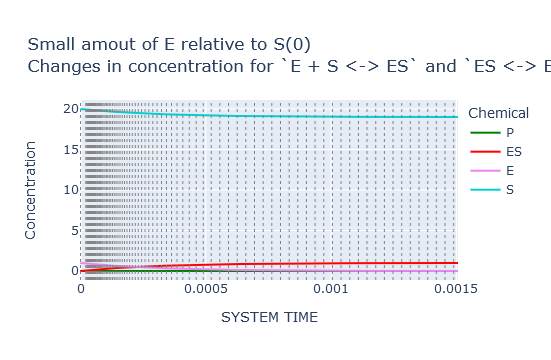

In [12]:
uc.plot_history(show_intervals=True, 
                title_prefix="Small amout of E relative to S(0)")

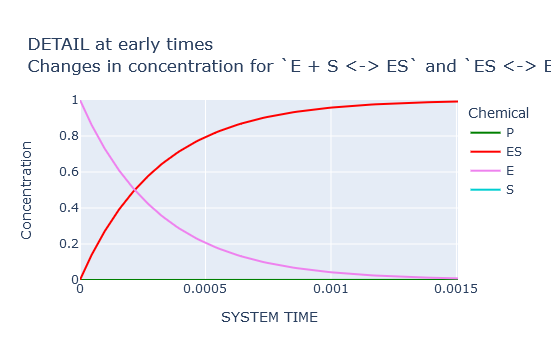

In [13]:
# Highlight a detail about the initial buildup of ES
uc.plot_history(title_prefix="DETAIL at early times",
                range_y=[0, 1])

### Notice the EXTREMELY fast kinetics involving the production of the intermediate `ES`

If one wishes to exam the history (of concentration or reaction-rate data) in tabular form, it can be done as follows:

In [14]:
uc.get_history()

,SYSTEM TIME,P,ES,E,S,step,caption
0,0.000000,0.000000e+00,0.000000,1.000000,20.000000,,Set concentration
1,0.000010,0.000000e+00,0.032000,0.968000,19.968000,1,1st reaction step
2,0.000021,2.041600e-07,0.066019,0.933981,19.933981,2,
3,0.000024,3.305201e-07,0.075849,0.924151,19.924151,3,
4,0.000025,3.740726e-07,0.078766,0.921234,19.921234,4,
...,...,...,...,...,...,...,...
169,0.001437,6.495498e-04,0.988861,0.011139,19.010489,169,
170,0.001454,6.594576e-04,0.989435,0.010565,19.009906,170,
171,0.001472,6.693712e-04,0.989979,0.010021,19.009352,171,
172,0.001489,6.792902e-04,0.990494,0.009506,19.008827,172,


In [15]:
uc.get_rate_history()

,SYSTEM TIME,rxn0_rate,rxn1_rate,step
0,0.000000,3200.000000,0.000000,0
1,0.000010,3092.640992,0.018560,1
2,0.000021,2978.868127,0.038291,2
3,0.000024,2946.061101,0.043992,3
4,0.000025,2936.333355,0.045684,4
...,...,...,...,...
168,0.001420,35.636312,0.573188,168
169,0.001437,33.792720,0.573539,169
170,0.001454,32.046189,0.573872,170
171,0.001472,30.391600,0.574188,171


Note that rates are associated with the START times of the intervals.  So, at the end time of the simulation, there's no rate.

#### Advance the reactions to equilibrium

In [16]:
# From now on, the data from 1 of every 10 computation steps will be saved in the history (for later use in plots, etc). 
# Until this point, we've used the default of 1
uc.enable_history(frequency=10)

# Continue the reactions
uc.single_compartment_react(duration=40., initial_step=0.00001)

... running : currently at System Time 16.81 (doing step size 0.00012) after running for 0.5 min
110938 total variable step(s) taken in 0.67 min
Number of step re-do's because of negative concentrations: 4571
Number of step re-do's because of elective soft aborts: 6
Norm usage: {'norm_A': 110781, 'norm_B': 110800, 'norm_C': 110781, 'norm_D': 110781}
System Time is now: 40.002


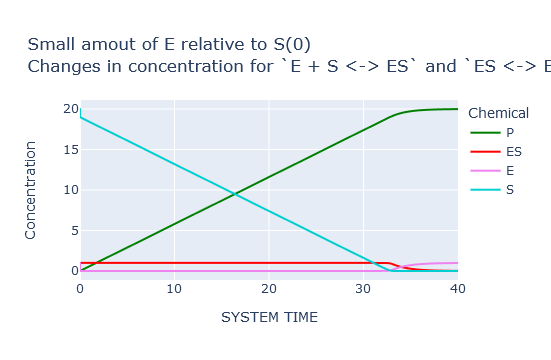

In [17]:
uc.plot_history(title_prefix="Small amout of E relative to S(0)")

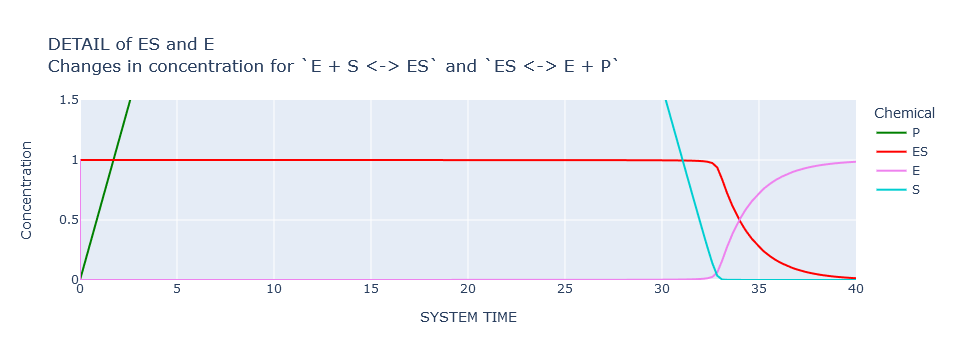

In [18]:
# Highlight a detail about the initial buildup of ES
uc.plot_history(title_prefix="DETAIL of ES and E",
                range_y=[0, 1.5])

#### Notice how the bound enzyme `ES` (red) quickly builds up at the very beginning, from time 0 to roughly 0.01 ... and that, in the longer term, the enzyme returns to its unbound state `E`

### What is the initial rate of production of the final reaction product `P`?   
One could take the numerical derivative (gradient) of the time values of [P] - but no need to!  **Reaction rates are computed in the course of the simulation, and stored in a rate-history dataframe** (as we also saw earlier)

In [19]:
rates = uc.get_rate_history()
rates

,SYSTEM TIME,rxn0_rate,rxn1_rate,step
0,0.000000,3200.000000,0.000000,0
1,0.000010,3092.640992,0.018560,1
2,0.000021,2978.868127,0.038291,2
3,0.000024,2946.061101,0.043992,3
4,0.000025,2936.333355,0.045684,4
...,...,...,...,...
11262,39.665419,-0.000790,0.010425,110889
11263,39.670501,-0.000339,0.010393,110899
11264,39.683681,-0.000027,0.010313,110909
11265,39.717866,0.000006,0.010110,110919


Note that initially we were saving historical data at every simulation step, but later switched to every 10 steps

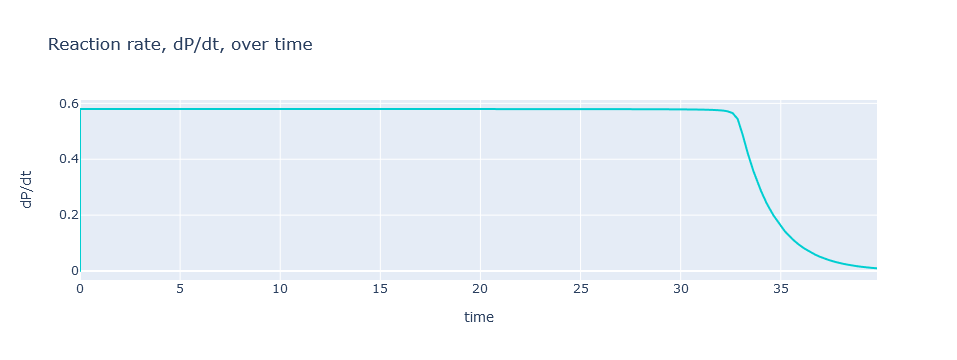

In [20]:
# Let's take a look at how the reaction rate varies with time
PlotlyHelper.plot_pandas(df=rates, 
                         title="Reaction rate, dP/dt, over time",
                         x_var="SYSTEM TIME", fields="rxn1_rate", 
                         x_label="time", y_label="dP/dt")

### Notice how very different is it from the Reaction rate over time seen in experiment `enzyme_1_a`

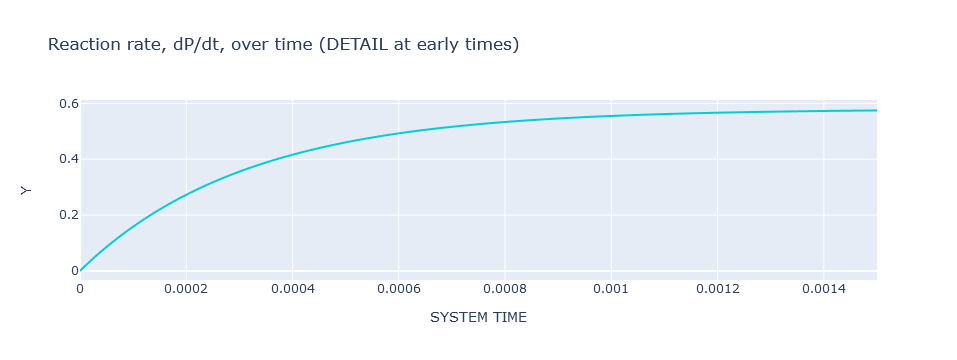

In [21]:
# A closer peek at its very quick buildup
PlotlyHelper.plot_pandas(df=rates, 
                         title="Reaction rate, dP/dt, over time (DETAIL at early times)",
                         x_var="SYSTEM TIME", fields="rxn1_rate", 
                         range_x=[0, 0.0015])

As we saw earlier, the time it took for `ES` to build up was about 0.001  
**Ignoring the very brief initial transient phase, the reaction rate starts at about 0.57, and stays at that value until the substrate gets depleted, arount t=33**

# 2. Comparing the results to the Michaelis-Menten model approximation

### Let's compute some parameters used by the Michaelis-Menten model   
for background reference, see:  https://vallance.chem.ox.ac.uk/pdfs/KineticsLectureNotes.pdf (p. 20)

In [22]:
reactions = uc.get_reactions()

In [23]:
rxn = ReactionEnz(enzyme="E", substrate="S", product="P",
                  k1_F=reactions.get_forward_rate(0), k1_R=reactions.get_reverse_rate(0), 
                  k2_F=reactions.get_forward_rate(1))

In [24]:
rxn.kM          #  For the data in this experiment, it comes out to (0.089 + 0.58) / 160.

0.004181249999999999

In [25]:
rxn.kcat

0.58

In [26]:
vmax = rxn.compute_vmax(E_tot=E0)          # kcat * E0
vmax

0.58

In [27]:
initial_rxn_rate = rxn.compute_rate(S_conc=S0)    #  (vmax * S0) / (kM + S0)
initial_rxn_rate

0.5798787690948362

Pretty close the value of about 0.57 we saw earlier, after the initial transient...   

### Now, let's look at the reaction rate that produces `P` as a function of [S]; we'll compare what we computed earlier vs. what is given by the approximation of the **Michaelis-Menten model**

First, we'll merge the concentration history and and the rate history into a single dataframe `df`

In [28]:
df = uc.add_rate_to_conc_history(rate_name="rxn1_rate", new_rate_name="P_rate")
df

,SYSTEM TIME,P,ES,E,S,step,caption,P_rate
0,0.000000,0.000000e+00,0.000000,1.000000,20.000000,,Set concentration,0.000000
1,0.000010,0.000000e+00,0.032000,0.968000,19.968000,1,1st reaction step,0.018560
2,0.000021,2.041600e-07,0.066019,0.933981,19.933981,2,,0.038291
3,0.000024,3.305201e-07,0.075849,0.924151,19.924151,3,,0.043992
4,0.000025,3.740726e-07,0.078766,0.921234,19.921234,4,,0.045684
...,...,...,...,...,...,...,...,...
11262,39.665419,1.998202e+01,0.017975,0.982025,0.000005,110889,,0.010425
11263,39.670501,1.998207e+01,0.017919,0.982081,0.000008,110899,,0.010393
11264,39.683681,1.998221e+01,0.017781,0.982219,0.000010,110909,,0.010313
11265,39.717866,1.998256e+01,0.017431,0.982569,0.000010,110919,,0.010110


In [29]:
# Let's add a column with the rate estimated by the Michaelis-Menten model
df["Michaelis_rate"] = rxn.compute_rate(S_conc=df["S"])
df

,SYSTEM TIME,P,ES,E,S,step,caption,P_rate,Michaelis_rate
0,0.000000,0.000000e+00,0.000000,1.000000,20.000000,,Set concentration,0.000000,0.579879
1,0.000010,0.000000e+00,0.032000,0.968000,19.968000,1,1st reaction step,0.018560,0.579879
2,0.000021,2.041600e-07,0.066019,0.933981,19.933981,2,,0.038291,0.579878
3,0.000024,3.305201e-07,0.075849,0.924151,19.924151,3,,0.043992,0.579878
4,0.000025,3.740726e-07,0.078766,0.921234,19.921234,4,,0.045684,0.579878
...,...,...,...,...,...,...,...,...,...
11262,39.665419,1.998202e+01,0.017975,0.982025,0.000005,110889,,0.010425,0.000714
11263,39.670501,1.998207e+01,0.017919,0.982081,0.000008,110899,,0.010393,0.001106
11264,39.683681,1.998221e+01,0.017781,0.982219,0.000010,110909,,0.010313,0.001370
11265,39.717866,1.998256e+01,0.017431,0.982569,0.000010,110919,,0.010110,0.001371


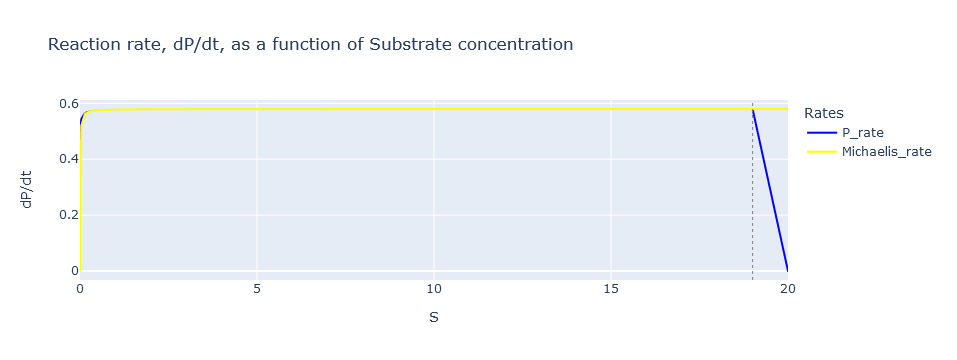

In [30]:
# Let's see how our computed rate compares with the approximations from the Michaelis-Menten model
PlotlyHelper.plot_pandas(df=df, x_var="S", fields=["P_rate", "Michaelis_rate"],
                         title="Reaction rate, dP/dt, as a function of Substrate concentration",
                         y_label="dP/dt", legend_header="Rates",
                         vertical_lines_to_add=19, colors=["blue", "yellow"])

Let's recall that our reactions started with [S]=20  
Virtually overlapped plots, except at the very right! (very early times, when [S] is greater than about 19)

The overlap at the very left (small [S], late in the reaction) has a few issues, but not too bad; let's magnify the previous plot:

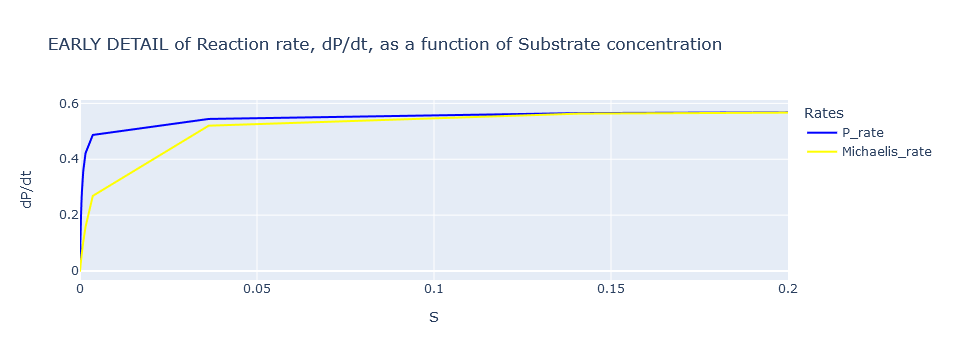

In [31]:
PlotlyHelper.plot_pandas(df=df, x_var="S", fields=["P_rate", "Michaelis_rate"],
                         title="EARLY DETAIL of Reaction rate, dP/dt, as a function of Substrate concentration",
                         y_label="dP/dt", legend_header="Rates",
                         vertical_lines_to_add=19, colors=["blue", "yellow"],
                         range_x=[0, .2])

## In this scenario, the Michaelis-Menten model is remarkable accurate EXCEPT at the very early times of the reaction (the large values of `S`), which is the brief initial transient phase when `ES` builds up from zero.  
### Some discrepancy also at the end of the reaction (when `S` drops to zero)

#### This is as expected, because the kinetic parameters of this reaction satisfy the key Michaelis-Menten assumptions that `[E] << [S]` , but NOT the other assumption that the rates satisfy `k1_reverse >> k2_forward`

# 3. Comparing the results to the Morrison model

#### Following section 7.1 of _"Analysis of Enzyme Reaction Kinetics, Vol. 1", by F. Xavier Malcata, Wiley, 2023_, we'll test out an the alternative **Morrison** approach, which is expected to perform better than the **Michaelis-Menten** model when the Enzyme concentration isn't so small.  But, in this scenario, we only have small amounts of enzyme - and we'll see below that no significant improvement is gained by switching model.

In [32]:
df["Morrison_rate"] = rxn.compute_rate_morrison(E_tot=E0,
                                                S_tot=df["S"] + df["ES"])
df

,SYSTEM TIME,P,ES,E,S,step,caption,P_rate,Michaelis_rate,Morrison_rate
0,0.000000,0.000000e+00,0.000000,1.000000,20.000000,,Set concentration,0.000000,0.579879,0.579872
1,0.000010,0.000000e+00,0.032000,0.968000,19.968000,1,1st reaction step,0.018560,0.579879,0.579872
2,0.000021,2.041600e-07,0.066019,0.933981,19.933981,2,,0.038291,0.579878,0.579872
3,0.000024,3.305201e-07,0.075849,0.924151,19.924151,3,,0.043992,0.579878,0.579872
4,0.000025,3.740726e-07,0.078766,0.921234,19.921234,4,,0.045684,0.579878,0.579872
...,...,...,...,...,...,...,...,...,...,...
11262,39.665419,1.998202e+01,0.017975,0.982025,0.000005,110889,,0.010425,0.000714,0.010384
11263,39.670501,1.998207e+01,0.017919,0.982081,0.000008,110899,,0.010393,0.001106,0.010354
11264,39.683681,1.998221e+01,0.017781,0.982219,0.000010,110909,,0.010313,0.001370,0.010275
11265,39.717866,1.998256e+01,0.017431,0.982569,0.000010,110919,,0.010110,0.001371,0.010073


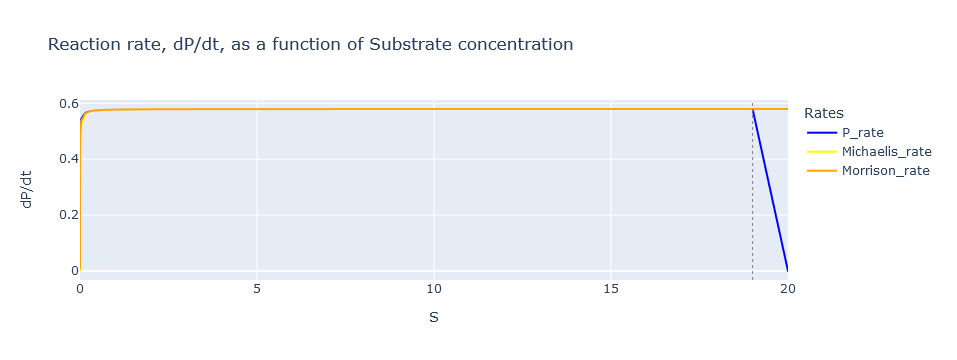

In [33]:
PlotlyHelper.plot_pandas(df=df, x_var="S", fields=["P_rate", "Michaelis_rate", "Morrison_rate"],
                         title="Reaction rate, dP/dt, as a function of Substrate concentration",
                         y_label="dP/dt", legend_header="Rates",
                         vertical_lines_to_add=19,
                         colors=["blue", "yellow", "orange"])

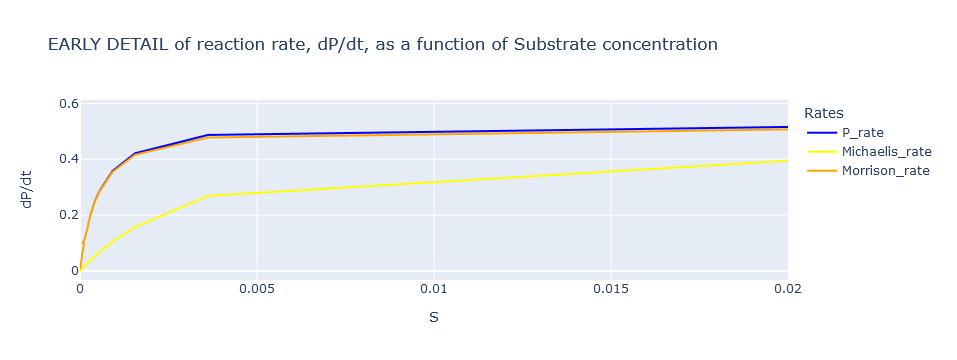

In [34]:
# Detail at the very left
PlotlyHelper.plot_pandas(df=df, x_var="S", fields=["P_rate", "Michaelis_rate", "Morrison_rate"],
                         title="EARLY DETAIL of reaction rate, dP/dt, as a function of Substrate concentration",
                         y_label="dP/dt", legend_header="Rates",
                         vertical_lines_to_add=19,
                         colors=["blue", "yellow", "orange"],
                         range_x=[0, 0.02])

# In this scenario, the Morrison model appears better than the Michaelis-Menten one at late reaction times (small `S`, close to zero) - and virtually identical elsewhere 